## TP FINAL DE FARERL PAMBO 

In [159]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import pandas as pd
from sklearn.impute import KNNImputer

## 1. Chargement des données :


In [160]:
# Charger seulement les 100 premières lignes du fichier Excel
file_path = 'D:\Analyse Python\comptages-routiers-permanents.csv'
# Spécifier la taille de chaque chunk (par exemple, 1 million de lignes par chunk)
chunksize = 100000

# Lire et traiter chaque chunk séparément
for chunk in pd.read_csv(file_path, chunksize=chunksize, sep=';', encoding='utf-8'):
    # Exemple de traitement sur chaque chunk
    # Par exemple, afficher les 5 premières lignes de chaque chunk
    print(chunk.head())
    
    # Ajouter ici tout autre traitement nécessaire (agrégation, filtrage, etc.)

<>:2: SyntaxWarning: invalid escape sequence '\A'
<>:2: SyntaxWarning: invalid escape sequence '\A'
C:\Users\Crede\AppData\Local\Temp\ipykernel_19116\1019024380.py:2: SyntaxWarning: invalid escape sequence '\A'
  file_path = 'D:\Analyse Python\comptages-routiers-permanents.csv'


   Identifiant arc          Libelle  Date et heure de comptage  Débit horaire  \
0             1069      Quai_d'Issy  2023-09-07T18:00:00+02:00         1582.0   
1              514     Bd_St_Marcel  2023-10-03T19:00:00+02:00          354.0   
2             6529         Pyrenees  2023-11-06T03:00:00+01:00           49.0   
3              489  Quai_St_Bernard  2023-12-07T10:00:00+01:00            NaN   
4             1952  Bd_des_Italiens  2024-01-04T17:00:00+01:00            NaN   

   Taux d'occupation Etat trafic  Identifiant noeud amont  \
0                NaN     Inconnu                      594   
1            2.88056      Fluide                      302   
2                NaN     Inconnu                     3384   
3                NaN     Inconnu                      291   
4            3.76389      Fluide                     2138   

                Libelle noeud amont  Identifiant noeud aval  \
0  Quai_Issy_W-Echangeur_Garigliano                     562   
1           Bd_Hopit

In [161]:
chunk

,Identifiant arc,Libelle,Date et heure de comptage,Débit horaire,Taux d'occupation,Etat trafic,Identifiant noeud amont,Libelle noeud amont,Identifiant noeud aval,Libelle noeud aval,Etat arc,Date debut dispo data,Date fin dispo data,geo_point_2d,geo_shape
27600000,1735,AI_Clignancourt,2024-03-30T01:00:00+01:00,NaN,3.64222,Fluide,893,Pte_Clignancourt-PE,3586,AI_Clignancourt-1,Ouvert,1996-10-03,2023-01-01,"48.90072120926486, 2.3448872762721633","{""coordinates"": [[2.344248090637455, 48.900652..."
27600001,6634,Pyrenees,2024-08-31T12:00:00+02:00,275.0,NaN,Inconnu,3436,Pyrenees-Levert,3384,Pyrenees-La_Mare,Invalide,2007-07-25,2023-01-01,"48.87372932630704, 2.389078338983582","{""coordinates"": [[2.3900682385129026, 48.87336..."
27600002,5677,Convention,2023-10-30T20:00:00+01:00,143.0,NaN,Inconnu,2974,Convention-Olivier_de_Serres,2914,Convention-Vaugirard,Invalide,1997-01-20,2023-01-01,"48.83699446501966, 2.2971807434058276","{""coordinates"": [[2.297928280404952, 48.836781..."
27600003,6948,AE_Clignancourt,2024-02-01T02:00:00+01:00,NaN,NaN,Inconnu,3603,AE_Clignancourt-1,922,AE_Clignancourt,Ouvert,2015-06-11,2023-01-01,"48.901086952680984, 2.342005350056629","{""coordinates"": [[2.3429466047733527, 48.90117..."
27600004,6295,Quai_Montebello,2024-03-31T06:00:00+02:00,439.0,4.02445,Fluide,59,Montebello-Archeveche,3267,Montebello-Haut_Pave,Invalide,2000-09-11,2023-01-01,"48.851411738274905, 2.350474979600701","{""coordinates"": [[2.351320742897111, 48.851124..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27633919,1638,Chapelle,2024-09-01T04:00:00+02:00,NaN,5.37278,Fluide,855,Marx_Dormoy-Ordener-Chapelle,868,Imp_Cure-Chapelle,Invalide,1996-10-03,2023-01-01,"48.89065032374796, 2.360026528633801","{""coordinates"": [[2.3600581455052363, 48.89029..."
27633920,1638,Chapelle,2024-09-01T03:00:00+02:00,NaN,5.71167,Fluide,855,Marx_Dormoy-Ordener-Chapelle,868,Imp_Cure-Chapelle,Invalide,1996-10-03,2023-01-01,"48.89065032374796, 2.360026528633801","{""coordinates"": [[2.3600581455052363, 48.89029..."
27633921,1638,Chapelle,2024-09-01T01:00:00+02:00,NaN,7.85000,Fluide,855,Marx_Dormoy-Ordener-Chapelle,868,Imp_Cure-Chapelle,Invalide,1996-10-03,2023-01-01,"48.89065032374796, 2.360026528633801","{""coordinates"": [[2.3600581455052363, 48.89029..."
27633922,1641,Chapelle,2024-09-01T03:00:00+02:00,NaN,NaN,Inconnu,869,Seguin-Chapelle,868,Imp_Cure-Chapelle,Invalide,1996-10-03,2023-01-01,"48.89149753626788, 2.3597332333993717","{""coordinates"": [[2.359687842525354, 48.891992..."


## 2. Suppression des colonnes inutiles :

In [162]:
for chunk in pd.read_csv(file_path, chunksize=chunksize, sep=';', encoding='utf-8'):
    # Suppression des colonnes inutiles
    colonnes_a_supprimer = [
        'Identifiant noeud amont', 'Libelle noeud amont',
        'Identifiant noeud aval', 'Libelle noeud aval', 'Etat arc',
    ]
    chunk.drop(columns=colonnes_a_supprimer, inplace=True)
    
    # Affichage d'un aperçu pour vérifier
    print(chunk.head())

   Identifiant arc          Libelle  Date et heure de comptage  Débit horaire  \
0             1069      Quai_d'Issy  2023-09-07T18:00:00+02:00         1582.0   
1              514     Bd_St_Marcel  2023-10-03T19:00:00+02:00          354.0   
2             6529         Pyrenees  2023-11-06T03:00:00+01:00           49.0   
3              489  Quai_St_Bernard  2023-12-07T10:00:00+01:00            NaN   
4             1952  Bd_des_Italiens  2024-01-04T17:00:00+01:00            NaN   

   Taux d'occupation Etat trafic Date debut dispo data Date fin dispo data  \
0                NaN     Inconnu            1996-10-03          2023-01-01   
1            2.88056      Fluide            2005-01-01          2019-06-01   
2                NaN     Inconnu            2003-03-11          2023-01-01   
3                NaN     Inconnu            1996-10-03          2023-01-01   
4            3.76389      Fluide            1996-10-03          2023-01-01   

                             geo_point_2d  \

En conservant uniquement les colonnes quantitatives et les identifiants essentiels, nous simplifions le DataFrame et nous concentrons sur les informations directement liées à l'analyse de trafic. Les colonnes textuelles et les identifiants de noeud peuvent introduire des complexités supplémentaires sans apporter de valeur analytique pour cet objectif spécifique.

En résumé, la suppression des colonnes de noeuds et des libellés textuels permet de rendre l'analyse plus claire et de se focaliser sur les variables directement pertinentes pour l’étude du trafic sur les segments de route

## 3. Nettoyage des doublons et des valeurs manquantes :


Gestion de doublon 

In [163]:
# Identifier les doublons en fonction des colonnes 'periode_seconde' et 'troncon'
doublons = chunk[chunk.duplicated(subset=['Date et heure de comptage', 'Identifiant arc'], keep=False)]
doublons

,Identifiant arc,Libelle,Date et heure de comptage,Débit horaire,Taux d'occupation,Etat trafic,Date debut dispo data,Date fin dispo data,geo_point_2d,geo_shape


Valeur Manquante

In [164]:
# Supposons que df soit déjà défini
data_info = []
columns = chunk.columns

for col in columns:
    missing_values = chunk[col].isnull().sum()  # Nombre de valeurs manquantes
    total_values = chunk[col].shape[0]  # Nombre total de valeurs
    null_percentage = (missing_values / total_values) * 100  # Calculer le pourcentage de valeurs manquantes
    data_type = chunk[col].dtype  # Type de données

    # Ajouter les informations à la liste
    data_info.append({
        "Colonne": col, 
        "Nombre de valeurs manquantes": missing_values, 
        "Pourcentage de valeurs manquantes (%)": null_percentage,
        "Type de données": data_type
    })

# Créer le DataFrame à partir de la liste
df_info = pd.DataFrame(data_info)

# Afficher le DataFrame
df_info = df_info.sort_values(by="Nombre de valeurs manquantes", ascending=False)
df_info


,Colonne,Nombre de valeurs manquantes,Pourcentage de valeurs manquantes (%),Type de données
3,Débit horaire,17766,52.370004,float64
4,Taux d'occupation,17274,50.919703,float64
6,Date debut dispo data,228,0.672091,object
7,Date fin dispo data,228,0.672091,object
8,geo_point_2d,228,0.672091,object
9,geo_shape,228,0.672091,object
0,Identifiant arc,0,0.000000,int64
1,Libelle,0,0.000000,object
2,Date et heure de comptage,0,0.000000,object
5,Etat trafic,0,0.000000,object


Interpolation est idéale pour des données qui suivent une tendance temporelle continue et où les valeurs manquantes sont peu nombreuses.
KNNImputer convient mieux lorsque les valeurs manquantes sont influencées par des points similaires mais sans continuité temporelle claire.
j'ai donc chois le méthode interpolate qui me semble la miux  méthode adaptée, pour  combler les valeurs manquantes efficacement tout en minimisant les distorsions dans tes données de trafic.

## 4. Formatage des types de données :

In [165]:
# Renommer les colonnes pour éviter les conflits
chunk.rename(columns={'Débit horaire': 'Debit_horaire', "Taux d'occupation": 'Taux_occupation'}, inplace=True)

# Initialisation de KNNImputer avec 5 voisins
imputer = KNNImputer(n_neighbors=5)

# Appliquer l'imputation sur les colonnes 'Debit_horaire' et 'Taux_occupation'
chunk[['Debit_horaire', 'Taux_occupation']] = imputer.fit_transform(chunk[['Debit_horaire', 'Taux_occupation']])

print("\nDonnées après imputation avec KNN :")
print(chunk)


Données après imputation avec KNN :
          Identifiant arc          Libelle  Date et heure de comptage  \
27600000             1735  AI_Clignancourt  2024-03-30T01:00:00+01:00   
27600001             6634         Pyrenees  2024-08-31T12:00:00+02:00   
27600002             5677       Convention  2023-10-30T20:00:00+01:00   
27600003             6948  AE_Clignancourt  2024-02-01T02:00:00+01:00   
27600004             6295  Quai_Montebello  2024-03-31T06:00:00+02:00   
...                   ...              ...                        ...   
27633919             1638         Chapelle  2024-09-01T04:00:00+02:00   
27633920             1638         Chapelle  2024-09-01T03:00:00+02:00   
27633921             1638         Chapelle  2024-09-01T01:00:00+02:00   
27633922             1641         Chapelle  2024-09-01T03:00:00+02:00   
27633923             1641         Chapelle  2024-09-01T02:00:00+02:00   

          Debit_horaire  Taux_occupation Etat trafic Date debut dispo data  \
27600000

In [166]:

# Supposons que df soit déjà défini
data_info = []
columns = chunk.columns

for col in columns:
    missing_values = chunk[col].isnull().sum()  # Nombre de valeurs manquantes
    total_values = chunk[col].shape[0]  # Nombre total de valeurs
    null_percentage = (missing_values / total_values) * 100  # Calculer le pourcentage de valeurs manquantes
    data_type = chunk[col].dtype  # Type de données

    # Ajouter les informations à la liste
    data_info.append({
        "Colonne": col, 
        "Nombre de valeurs manquantes": missing_values, 
        "Pourcentage de valeurs manquantes (%)": null_percentage,
        "Type de données": data_type
    })

# Créer le DataFrame à partir de la liste
df_info = pd.DataFrame(data_info)

# Afficher le DataFrame
df_info = df_info.sort_values(by="Nombre de valeurs manquantes", ascending=False)
df_info


,Colonne,Nombre de valeurs manquantes,Pourcentage de valeurs manquantes (%),Type de données
6,Date debut dispo data,228,0.672091,object
7,Date fin dispo data,228,0.672091,object
8,geo_point_2d,228,0.672091,object
9,geo_shape,228,0.672091,object
0,Identifiant arc,0,0.000000,int64
1,Libelle,0,0.000000,object
2,Date et heure de comptage,0,0.000000,object
3,Debit_horaire,0,0.000000,float64
4,Taux_occupation,0,0.000000,float64
5,Etat trafic,0,0.000000,object


Formater la colonne en datetime 

## 5. Statistiques descriptives :

• Calculez des statistiques descriptives pour le débit horaire et le taux d’occupation
sur chaque tronçon. Par exemple, vous devrez montrer :
o La moyenne, la médiane, l’écart-type pour comprendre la répartition du
trafic.


In [167]:
# Supposons que 'data' soit ton DataFrame contenant les colonnes 'Identifiant arc', 'Débit horaire', et 'Taux d’occupation'

# Calcul des statistiques descriptives par tronçon ('Identifiant arc')
statistiques_trafic = chunk.groupby('Identifiant arc').agg(
    Moyenne_Débit=('Debit_horaire', 'mean'),
    Médiane_Débit=('Debit_horaire', 'median'),
    Écart_type_Débit=('Debit_horaire', 'std'),
    Moyenne_Taux_Occupation=('Taux_occupation', 'mean'),
    Médiane_Taux_Occupation=('Taux_occupation', 'median'),
    Écart_type_Taux_Occupation=('Taux_occupation', 'std')
).reset_index()

# Afficher les statistiques
statistiques_trafic.head()

,Identifiant arc,Moyenne_Débit,Médiane_Débit,Écart_type_Débit,Moyenne_Taux_Occupation,Médiane_Taux_Occupation,Écart_type_Taux_Occupation
0,1,266.800000,263.800000,13.068027,3.031112,3.249170,0.882700
1,2,444.200000,418.400000,246.452819,5.907778,6.219445,2.734719
2,3,453.088594,453.088594,0.000000,5.258332,5.258332,0.000000
3,4,221.400000,186.200000,76.631064,3.394585,3.168335,1.636119
4,5,1157.833333,1251.000000,277.527236,10.702317,10.994445,2.637679


. Exploration des extrêmes (les moments de débit maximal et minimal, les
heures les plus congestionnées).

In [185]:
# Moments de débit maximal et minimal par tronçon
extremes_debit = chunk.groupby('Identifiant arc').agg(
    Débit_Max=('Debit_horaire', 'max'),
    Débit_Min=('Debit_horaire', 'min')
).reset_index()

# Moments de taux d'occupation maximal et minimal par tronçon
extremes_taux_occupation = chunk.groupby('Identifiant arc').agg(
    Taux_Occupation_Max=('Taux_occupation', 'max'),
    Taux_Occupation_Min=('Taux_occupation', 'min')
).reset_index()

# Extraire les heures des moments de debit_horaire maximal et minimal
heures_congestion_debit = chunk.loc[chunk.groupby('Identifiant arc')['Debit_horaire'].idxmax(), 
                                   ['Identifiant arc', 'Date et heure de comptage', 'Debit_horaire']]

# Extraire les heures des moments de taux d'occupation maximal
heures_congestion_occupation = chunk.loc[chunk.groupby('Identifiant arc')['Taux_occupation'].idxmax(), 
                                        ['Identifiant arc', 'Date et heure de comptage', 'Taux_occupation']]

# Afficher les résultats
print("Débit maximal et minimal par tronçon :")
print(extremes_debit.head())

print("\nTaux d'occupation maximal et minimal par tronçon :")
print(extremes_taux_occupation.head())

print("\nHeures avec debit_horaire maximal :")
print(heures_congestion_debit.head())

print("\nHeures avec taux d'occupation maximal :")
print(heures_congestion_occupation.head())


Débit maximal et minimal par tronçon :
   Identifiant arc    Débit_Max   Débit_Min
0                1   285.200000  254.400000
1                2   864.600000  191.200000
2                3   453.088594  453.088594
3                4   335.800000  177.400000
4                5  1397.000000  653.000000

Taux d'occupation maximal et minimal par tronçon :
   Identifiant arc  Taux_Occupation_Max  Taux_Occupation_Min
0                1             3.790000             1.836110
1                2             9.256670             1.958330
2                3             5.258332             5.258332
3                4             5.568340             1.673330
4                5            13.855560             6.123890

Heures avec debit_horaire maximal :
          Identifiant arc  Date et heure de comptage  Debit_horaire
27616874                1  2024-02-01T02:00:00+01:00     285.200000
27616584                2  2023-11-01T01:00:00+01:00     864.600000
27610456                3  2024-02-01T

1. Moyenne, Médiane, et Écart-Type
Moyenne : Indique le débit horaire moyen ou le taux d’occupation moyen d’un tronçon, ce qui donne une vue d'ensemble du niveau de trafic typique. C'est essentiel pour savoir si le trafic est généralement élevé, faible, ou modéré sur un segment de route.
Médiane : Moins influencée par les valeurs extrêmes (comme des pics de trafic anormaux), la médiane fournit une mesure robuste du débit ou de l'occupation typiques, utile pour comprendre le niveau de trafic normal sans être biaisé par des anomalies.
Écart-Type : Montre la variabilité autour de la moyenne. Un écart-type élevé indique de fortes fluctuations dans le trafic, ce qui peut signaler des périodes de congestion soudaines ou des variations imprévisibles dans la circulation.
2. Exploration des Extrêmes
Débit maximal et minimal : Ces valeurs montrent les pics et creux de trafic, essentiels pour identifier les périodes critiques où un tronçon est le plus encombré ou, au contraire, le moins utilisé. Cela aide à repérer les heures de pointe ou les périodes creuses.
Heures les plus congestionnées : Connaître les heures de la journée où le taux d’occupation et le débit horaire sont les plus élevés permet d'identifier les périodes de congestion intense, facilitant la planification d'interventions (par exemple, ajuster les feux de signalisation ou rediriger le trafic) pour éviter les embouteillages.
Importance de ces indicateurs
Ces indicateurs fournissent une vue complète des conditions de trafic sur chaque tronçon, permettant d’anticiper les périodes de congestion et d’optimiser la gestion des routes. En comprenant la répartition et la variabilité du trafic, il devient possible de prendre des décisions éclairées pour améliorer la fluidité de la circulation et réduire les temps d'attente.

## 6. Analyse des séries temporelles :

Certaines valeurs n'ont pas pu être converties en datetime.


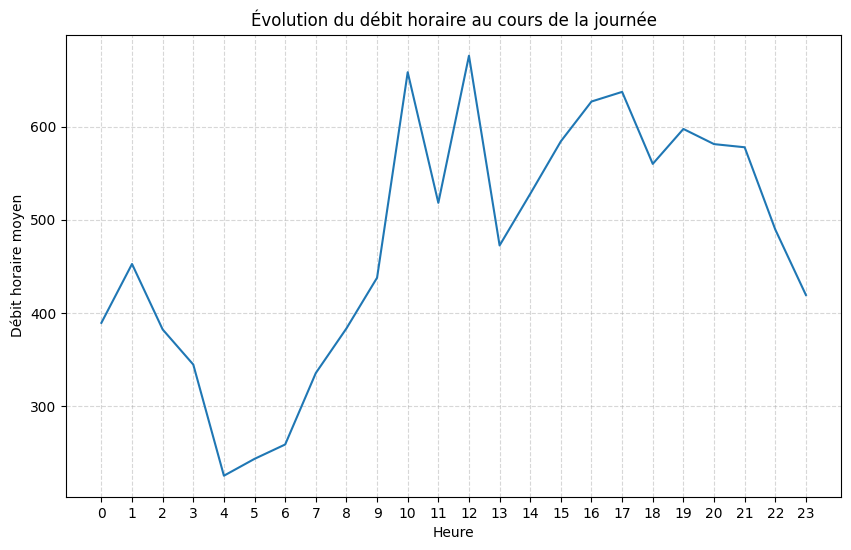

In [189]:
# Conversion de la colonne 'Date et heure de comptage' en format datetime
chunk['Date et heure de comptage'] = pd.to_datetime(chunk['Date et heure de comptage'], errors='coerce')

# Vérifier si la conversion a réussi et traiter les valeurs non converties si nécessaire
if chunk['Date et heure de comptage'].isnull().any():
    print("Certaines valeurs n'ont pas pu être converties en datetime.")

# Créer les colonnes 'Jour' et 'Heure' 
chunk['Jour'] = chunk['Date et heure de comptage'].dt.dayofweek  # 0 = Lundi, 6 = Dimanche
chunk['Heure'] = chunk['Date et heure de comptage'].dt.hour

# Création du graphique
plt.figure(figsize=(10, 6))
sns.lineplot(data=chunk, x='Heure', y='Debit_horaire', errorbar=None)
plt.title("Évolution du débit horaire au cours de la journée")
plt.xlabel("Heure")
plt.ylabel("Débit horaire moyen")
plt.xticks(range(0, 24))  # Afficher toutes les heures de 0 à 23
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()


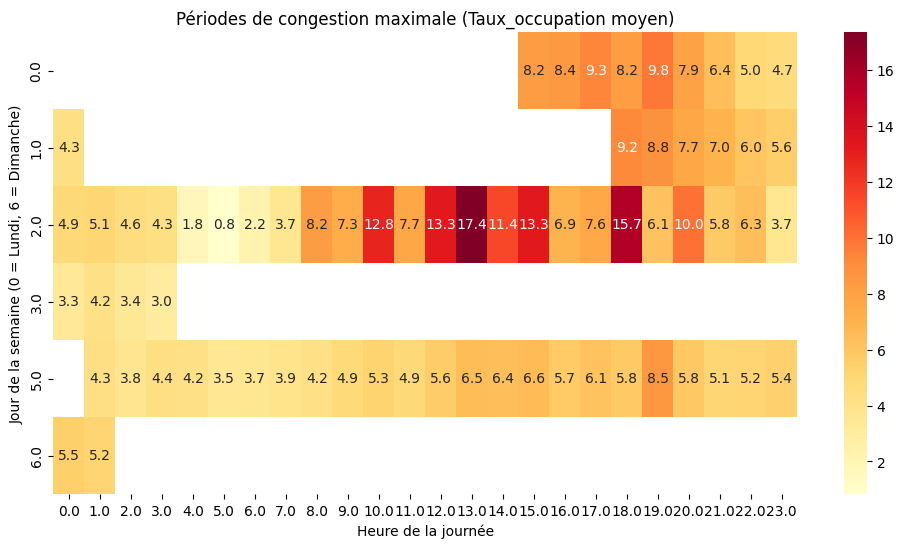

In [190]:
# Heatmap : Périodes de congestion maximale sur la semaine
# Calculer la moyenne du taux d'occupation par jour de la semaine et heure
occupation_heatmap = chunk.pivot_table(index='Jour', columns='Heure', values="Taux_occupation", aggfunc='mean')

plt.figure(figsize=(12, 6))
sns.heatmap(occupation_heatmap, cmap="YlOrRd", annot=True, fmt=".1f")
plt.title("Périodes de congestion maximale (Taux_occupation moyen)")
plt.xlabel("Heure de la journée")
plt.ylabel("Jour de la semaine (0 = Lundi, 6 = Dimanche)")
plt.show()

Explication de l'Analyse des Séries Temporelles
Line Plots (Évolution du trafic horaire au cours de la journée) :

Les line plots permettent de visualiser les fluctuations du débit et du taux d’occupation à chaque heure de la journée. En analysant ces courbes, on peut identifier les pics de trafic, souvent en début et en fin de journée (heures de pointe), ainsi que les périodes de trafic plus faible. Cela révèle les moments de la journée où le trafic est le plus dense, ce qui est essentiel pour anticiper les périodes de congestion et adapter la gestion du trafic.
Heatmaps (Périodes de congestion maximale sur la semaine) :

Les heatmaps montrent les variations de trafic tout au long de la semaine, avec des niveaux de congestion codés par couleur. Cela met en évidence les différences de trafic entre les jours de semaine et le weekend. Typiquement, les jours de semaine présentent des heures de pointe bien marquées (le matin et le soir), tandis que le weekend, les flux de trafic peuvent être plus constants et moins congestionnés, mais parfois plus élevés en journée. La heatmap aide à identifier les jours et heures critiques pour la planification et les interventions.
Importance de l’Analyse
Cette analyse temporelle est cruciale pour la gestion proactive du trafic. En comprenant les variations de trafic en fonction des heures et des jours, les gestionnaires peuvent prendre des mesures ciblées pour réduire les embouteillages aux moments critiques et optimiser le flux de circulation en semaine et pendant les weekends. Cela permet une planification optimale des ressources et une meilleure expérience pour les usagers de la route.

## 7. Visualisations ciblées :


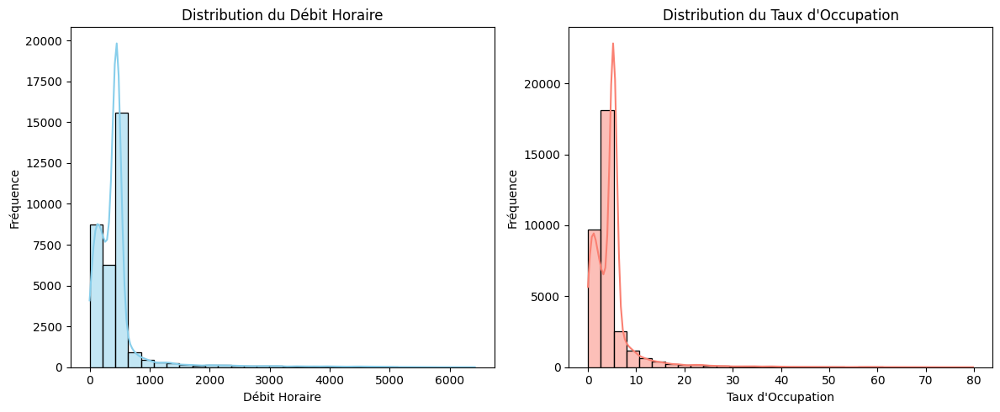

In [191]:
# Histogrammes pour la distribution du debit_horaire et du taux d'occupation
plt.figure(figsize=(12, 5))

# Histogramme pour la distribution du debit_horaire
plt.subplot(1, 2, 1)
sns.histplot(chunk['Debit_horaire'], bins=30, kde=True, color="skyblue")
plt.title("Distribution du Débit Horaire")
plt.xlabel("Débit Horaire")
plt.ylabel("Fréquence")

# Histogramme pour la distribution du taux d'occupation
plt.subplot(1, 2, 2)
sns.histplot(chunk["Taux_occupation"], bins=30, kde=True, color="salmon")
plt.title("Distribution du Taux d'Occupation")
plt.xlabel("Taux d'Occupation")
plt.ylabel("Fréquence")

plt.tight_layout()
plt.show()

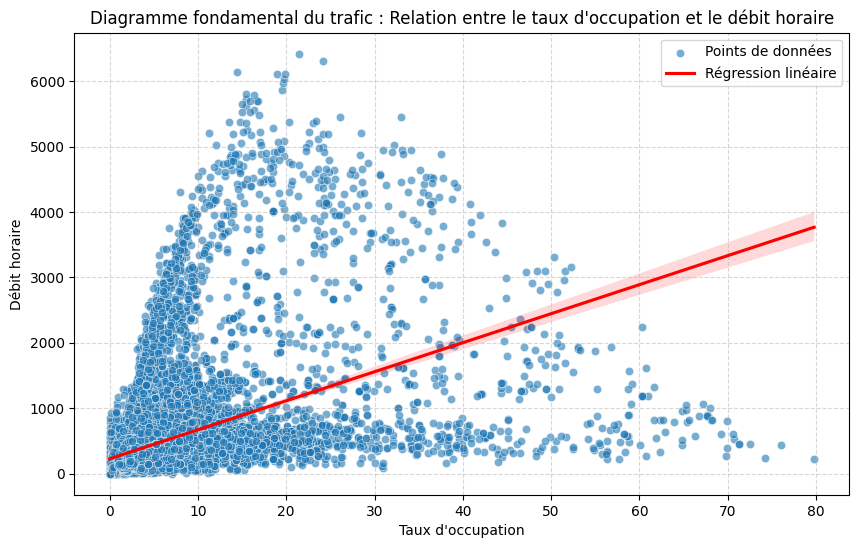

In [192]:
# Scatter plot avec régression linéaire
plt.figure(figsize=(10, 6))
sns.scatterplot(data=chunk, x='Taux_occupation', y='Debit_horaire', alpha=0.6, label="Points de données")
sns.regplot(data=chunk, x='Taux_occupation', y='Debit_horaire', scatter=False, color="red", label="Régression linéaire")

# Titre et étiquettes des axes
plt.title("Diagramme fondamental du trafic : Relation entre le taux d'occupation et le débit horaire")
plt.xlabel("Taux d'occupation")
plt.ylabel("Débit horaire")
plt.legend()  # Afficher la légende pour distinguer les points et la ligne de régression
plt.grid(True, linestyle='--', alpha=0.5)  # Ajouter une grille pour plus de clarté
plt.show()


Explication des Visualisations Ciblées
Histogrammes (Distribution du débit horaire et du taux d'occupation) :

Les histogrammes permettent de visualiser la répartition du débit horaire et du taux d'occupation, révélant la fréquence des différents niveaux de trafic. En analysant la forme de la distribution, on peut voir si la majorité des valeurs se concentrent autour de certains niveaux (indiquant des conditions de trafic habituelles) ou si elles sont réparties de manière uniforme ou asymétrique. Par exemple, une concentration de valeurs élevées indiquerait une fréquence élevée de congestion. Cette visualisation aide à comprendre les niveaux typiques et les anomalies dans le trafic.
Scatter Plot (Relation entre le taux d’occupation et le débit - “Diagramme Fondamental”) :

Le scatter plot illustre la relation entre le débit horaire et le taux d’occupation, un concept central dans le “diagramme fondamental” du trafic. Cette visualisation montre comment, pour un même niveau de débit, le trafic peut être fluide ou congestionné selon le taux d’occupation. Par exemple, un débit similaire avec un taux d’occupation bas indique un trafic fluide, tandis qu’un taux élevé pour ce même débit signale une congestion. Cela aide à identifier les conditions de saturation et à comprendre comment la densité des véhicules affecte la fluidité du trafic.
Importance des Visualisations
Ces graphiques sont essentiels pour illustrer et expliquer les patterns de trafic de manière visuelle et intuitive. L’histogramme aide à saisir les conditions générales de trafic et à repérer les valeurs anormales, tandis que le scatter plot met en évidence les moments de saturation et les niveaux de fluidité possibles à différents débits. Ces visualisations permettent ainsi de comprendre la dynamique du trafic et de cibler les interventions pour améliorer la fluidité, en fonction de la relation entre le débit et la densité de circulation.

## 8. Encodage des données catégorielles :

In [152]:
print(chunk.columns)


Index(['Identifiant arc', 'Libelle', 'Date et heure de comptage',
       'Debit_horaire', 'Taux_occupation', 'Etat trafic',
       'Date debut dispo data', 'Date fin dispo data', 'geo_point_2d',
       'geo_shape', 'Année', 'Mois', 'Jour', 'Jour de la semaine', 'Heure',
       'État_Trafic_Encoded'],
      dtype='object')


In [158]:
chunk['Etat trafic'], uniques =pd.factorize(chunk['Etat trafic'])
chunk

,Identifiant arc,Libelle,Date et heure de comptage,Debit_horaire,Taux_occupation,Etat trafic,Date debut dispo data,Date fin dispo data,geo_point_2d,geo_shape,Année,Mois,Jour,Jour de la semaine,Heure,État_Trafic_Encoded
27600000,1735,AI_Clignancourt,2024-03-30 01:00:00+01:00,338.600000,3.642220,0,1996-10-03,2023-01-01,"48.90072120926486, 2.3448872762721633","{""coordinates"": [[2.344248090637455, 48.900652...",2024,3,5,Saturday,1,0
27600001,6634,Pyrenees,2024-08-31 12:00:00+02:00,275.000000,7.194778,1,2007-07-25,2023-01-01,"48.87372932630704, 2.389078338983582","{""coordinates"": [[2.3900682385129026, 48.87336...",2024,8,5,Saturday,12,1
27600002,5677,Convention,2023-10-30 20:00:00+01:00,143.000000,1.361224,1,1997-01-20,2023-01-01,"48.83699446501966, 2.2971807434058276","{""coordinates"": [[2.297928280404952, 48.836781...",2023,10,0,Monday,20,1
27600003,6948,AE_Clignancourt,2024-02-01 02:00:00+01:00,453.088594,5.258332,1,2015-06-11,2023-01-01,"48.901086952680984, 2.342005350056629","{""coordinates"": [[2.3429466047733527, 48.90117...",2024,2,3,Thursday,2,1
27600004,6295,Quai_Montebello,2024-03-31 06:00:00+02:00,439.000000,4.024450,0,2000-09-11,2023-01-01,"48.851411738274905, 2.350474979600701","{""coordinates"": [[2.351320742897111, 48.851124...",2024,3,6,Sunday,6,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27633919,1638,Chapelle,2024-09-01 04:00:00+02:00,625.400000,5.372780,0,1996-10-03,2023-01-01,"48.89065032374796, 2.360026528633801","{""coordinates"": [[2.3600581455052363, 48.89029...",2024,9,6,Sunday,4,0
27633920,1638,Chapelle,2024-09-01 03:00:00+02:00,505.800000,5.711670,0,1996-10-03,2023-01-01,"48.89065032374796, 2.360026528633801","{""coordinates"": [[2.3600581455052363, 48.89029...",2024,9,6,Sunday,3,0
27633921,1638,Chapelle,2024-09-01 01:00:00+02:00,1919.800000,7.850000,0,1996-10-03,2023-01-01,"48.89065032374796, 2.360026528633801","{""coordinates"": [[2.3600581455052363, 48.89029...",2024,9,6,Sunday,1,0
27633922,1641,Chapelle,2024-09-01 03:00:00+02:00,453.088594,5.258332,1,1996-10-03,2023-01-01,"48.89149753626788, 2.3597332333993717","{""coordinates"": [[2.359687842525354, 48.891992...",2024,9,6,Sunday,3,1


In [155]:
# Par exemple, si les noms corrects sont 'État du trafic' et 'État de l'arc'
data_encoded = pd.get_dummies(chunk, columns=['Etat trafic', 'Identifiant arc'], drop_first=True)

# Afficher les premières lignes pour vérifier l'encodage
data_encoded.head()


,Libelle,Date et heure de comptage,Debit_horaire,Taux_occupation,Date debut dispo data,Date fin dispo data,geo_point_2d,geo_shape,Année,Mois,...,Identifiant arc_7202,Identifiant arc_7203,Identifiant arc_7204,Identifiant arc_7205,Identifiant arc_7215,Identifiant arc_7231,Identifiant arc_7250,Identifiant arc_7257,Identifiant arc_7264,Identifiant arc_7265
27600000,AI_Clignancourt,2024-03-30 01:00:00+01:00,338.600000,3.642220,1996-10-03,2023-01-01,"48.90072120926486, 2.3448872762721633","{""coordinates"": [[2.344248090637455, 48.900652...",2024,3,...,False,False,False,False,False,False,False,False,False,False
27600001,Pyrenees,2024-08-31 12:00:00+02:00,275.000000,7.194778,2007-07-25,2023-01-01,"48.87372932630704, 2.389078338983582","{""coordinates"": [[2.3900682385129026, 48.87336...",2024,8,...,False,False,False,False,False,False,False,False,False,False
27600002,Convention,2023-10-30 20:00:00+01:00,143.000000,1.361224,1997-01-20,2023-01-01,"48.83699446501966, 2.2971807434058276","{""coordinates"": [[2.297928280404952, 48.836781...",2023,10,...,False,False,False,False,False,False,False,False,False,False
27600003,AE_Clignancourt,2024-02-01 02:00:00+01:00,453.088594,5.258332,2015-06-11,2023-01-01,"48.901086952680984, 2.342005350056629","{""coordinates"": [[2.3429466047733527, 48.90117...",2024,2,...,False,False,False,False,False,False,False,False,False,False
27600004,Quai_Montebello,2024-03-31 06:00:00+02:00,439.000000,4.024450,2000-09-11,2023-01-01,"48.851411738274905, 2.350474979600701","{""coordinates"": [[2.351320742897111, 48.851124...",2024,3,...,False,False,False,False,False,False,False,False,False,False


In [171]:
!pip install shapely geopandas folium


   ---------------------------------------- 0.0/1.4 MB ? eta -:--:--
   ----- ---------------------------------- 0.2/1.4 MB 5.6 MB/s eta 0:00:01
   ------- -------------------------------- 0.3/1.4 MB 3.5 MB/s eta 0:00:01
   ---------- ----------------------------- 0.4/1.4 MB 3.0 MB/s eta 0:00:01
   --------------- ------------------------ 0.6/1.4 MB 2.9 MB/s eta 0:00:01
   -------------------- ------------------- 0.7/1.4 MB 3.4 MB/s eta 0:00:01
   -------------------------- ------------- 0.9/1.4 MB 3.5 MB/s eta 0:00:01
   --------------------------- ------------ 1.0/1.4 MB 3.5 MB/s eta 0:00:01
   ------------------------------- -------- 1.1/1.4 MB 3.0 MB/s eta 0:00:01
   ----------------------------------- ---- 1.3/1.4 MB 3.1 MB/s eta 0:00:01
   -------------------------------------- - 1.4/1.4 MB 3.1 MB/s eta 0:00:01
   ---------------------------------------- 1.4/1.4 MB 3.0 MB/s eta 0:00:00
   ---------------------------------------- 0.0/323.6 kB ? eta -:--:--
   ---------------------


[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [176]:
%pip install shapely geopandas folium


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [183]:
from shapely.geometry import Point
import geopandas as gpd
import folium
from IPython.display import display

# Suppression des valeurs nulles dans 'geo_point_2d'
chunk = chunk.dropna(subset=['geo_point_2d'])

# Conversion des points géographiques pour GeoDataFrame
chunk['geometry'] = chunk['geo_point_2d'].apply(lambda x: Point(map(float, x.split(','))) if isinstance(x, str) else np.nan)
gdf = gpd.GeoDataFrame(chunk, geometry='geometry')

# Création de la carte centrée sur Paris
m = folium.Map(location=[48.8566, 2.3522], zoom_start=12)

# Ajout des marqueurs avec la trace de marquage (couleur en fonction du débit horaire)
for _, row in gdf.dropna(subset=['geometry']).iterrows():  # Exclure les lignes sans géométrie
    folium.CircleMarker(
        location=(row.geometry.y, row.geometry.x),
        radius=5,
        color='red' if row['Debit_horaire'] > gdf['Debit_horaire'].quantile(0.75) else 'green',
        fill=True,
        fill_color='red' if row['Debit_horaire'] > gdf['Debit_horaire'].quantile(0.75) else 'green',
        fill_opacity=0.6,
        tooltip=f"Débit Horaire: {row['Debit_horaire']}<br>Taux Occupation: {row['Taux_occupation']}"
    ).add_to(m)

# Afficher la carte dans le notebook
display(m)
